<p align="center">
    <b><font size="6">Analyzing Temporal and Associative Relationships of Vaccine Adverse Events for Hepatitis B
vaccination</font></b>
</p>


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Data importing and Data Preprocessing

In [ ]:
from google.colab import drive
import pandas as pd
import os
import glob

# Mounting the Google Drive:
drive.mount('/content/drive')

"""
Folder path for the folder containg VAERS data ranging from 1990 to 2024 saved in google drive
A year(1990-2024) the data file is saved as yyyy_d.
A year(1990-2024) the symptoms file is saved as yyyy_s.
A year(1990-2024) the vacciene file is saved as yyyy_v.
"""

# Specifying the path to the folder containing the data:
folder_path = '/content/drive/MyDrive/Data'

# Specifying the path to the folder where the modified files will be saved:
output_path = '/content/drive/MyDrive/CS584_Project_GeneratedData'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Listing all the files in the VAERS data folder:
all_files = os.listdir(folder_path)
print(f'The number of files in the VAERS Data folder is:\n{len(all_files)}')
print("The list of all the files in the VAERS data folder is:")
for i in range(0, len(all_files), 5):
    print(all_files[i:i+5])


The number of files in the VAERS Data folder is:
106
The list of all the files in the VAERS data folder is:
['1990_D.csv', '1991_D.csv', '1990_V.csv', '1990_S.csv', '1991_S.csv']
['1991_V.csv', '1992_S.csv', '1992_D.csv', '1992_V.csv', '1993_D.csv']
['1993_S.csv', '1993_V.csv', '1994_S.csv', '1994_D.csv', '1994_V.csv']
['1995_D.csv', '1995_S.csv', '1995_V.csv', '1996_S.csv', '1996_D.csv']
['1996_V.csv', '1997_S.csv', '1997_D.csv', '1997_V.csv', '1998_S.csv']
['1998_D.csv', '1998_V.csv', '1999_D.csv', '1999_S.csv', '1999_V.csv']
['2000_D.csv', '2000_S.csv', '2000_V.csv', '2001_D.csv', '2001_S.csv']
['2001_V.csv', '2002_S.csv', '2002_V.csv', '2002_D.csv', '2003_S.csv']
['2003_D.csv', '2003_V.csv', '2004_D.csv', '2004_V.csv', '2004_S.csv']
['2005_S.csv', '2005_D.csv', '2005_V.csv', '2006_D.csv', '2006_S.csv']
['2006_V.csv', '2007_D.csv', '2007_S.csv', '2007_V.csv', '2008_V.csv']
['2008_D.csv', '2008_S.csv', '2009_D.csv', '2009_S.csv', '2009_V.csv']
['2010_D.csv', '2010_S.csv', '2010_V.csv

In [ ]:
# Extracting the years for which the data is present:
years = sorted(set([file[:4] for file in all_files if file.endswith('.csv')]))
print('The years for which the data is present are:')
for i in range(0, len(years), 5):
    print(years[i:i+5])

The years for which the data is present are:
['1990', '1991', '1992', '1993', '1994']
['1995', '1996', '1997', '1998', '1999']
['2000', '2001', '2002', '2003', '2004']
['2005', '2006', '2007', '2008', '2009']
['2010', '2011', '2012', '2013', '2014']
['2015', '2016', '2017', '2018', '2019']
['2020', '2021', '2022', '2023', '2024']


In [ ]:
# To stored combined data from all the years:
combined_data = []

# Inner joining the data, symptoms and vaccine files based on the VAERS_ID to created a combined file yyyy.csv with all the features for the year yyyy.

for year in years:
    try:
        # Construct file paths
        file_s = os.path.join(folder_path, f"{year}_S.csv")
        file_v = os.path.join(folder_path, f"{year}_V.csv")
        file_d = os.path.join(folder_path, f"{year}_D.csv")

        # Load the files with error handling for encoding
        df_s = pd.read_csv(file_s, encoding='ISO-8859-1', low_memory=False)
        df_v = pd.read_csv(file_v, encoding='ISO-8859-1', low_memory=False)
        df_d = pd.read_csv(file_d, encoding='ISO-8859-1', low_memory=False)


        # Perform inner join on VAERS_ID
        merged_data = df_s.merge(df_v, on="VAERS_ID", how="inner").merge(df_d, on="VAERS_ID", how="inner")

        # Save the yearly data as yyyy.csv
        yearly_output_file = os.path.join(output_path, f"{year}.csv")
        merged_data.to_csv(yearly_output_file, index=False)
        print(f"Created {year}.csv successfully.")

        # Append to combined data
        combined_data.append(merged_data)
    except Exception as e:
        print(f"Error processing year {year}: {e}")


Created 1990.csv successfully.
Created 1991.csv successfully.
Created 1992.csv successfully.
Created 1993.csv successfully.
Created 1994.csv successfully.
Created 1995.csv successfully.
Created 1996.csv successfully.
Created 1997.csv successfully.
Created 1998.csv successfully.
Created 1999.csv successfully.
Created 2000.csv successfully.
Created 2001.csv successfully.
Created 2002.csv successfully.
Created 2003.csv successfully.
Created 2004.csv successfully.
Created 2005.csv successfully.
Created 2006.csv successfully.
Created 2007.csv successfully.
Created 2008.csv successfully.
Created 2009.csv successfully.
Created 2010.csv successfully.
Created 2011.csv successfully.
Created 2012.csv successfully.
Created 2013.csv successfully.
Created 2014.csv successfully.
Created 2015.csv successfully.
Created 2016.csv successfully.
Created 2017.csv successfully.
Created 2018.csv successfully.
Created 2019.csv successfully.
Created 2020.csv successfully.
Created 2021.csv successfully.
Created 

In [ ]:
# Combining all the years data to one file called vaers.csv
if combined_data:
    data_csv = pd.concat(combined_data, ignore_index=True)
    data_csv_file = os.path.join(output_path, "vaers.csv")
    data_csv.to_csv(data_csv_file, index=False)
    print("Created vaers.csv successfully.")
else:
    print("No yearly data was processed, so data.csv could not be created.")

Created vaers.csv successfully.


In [ ]:
# Specifying the path of vaers.csv data file
file_path = "/content/drive/MyDrive/CS584_Project_GeneratedData/vaers.csv"
vaers_df = pd.read_csv(file_path, encoding='ISO-8859-1', low_memory=False)

# Printing the features (columns)
print("Features (Columns) in vaers.csv:")
print(vaers_df.columns)

# Printing the number of rows
print("\nNumber of rows in vaers.csv:")
print(len(vaers_df))

# Display the first few rows to inspect the data
print("\nFirst 5 rows of the data:")
print(vaers_df.head())


Features (Columns) in vaers.csv:
Index(['VAERS_ID', 'SYMPTOM1', 'SYMPTOMVERSION1', 'SYMPTOM2',
       'SYMPTOMVERSION2', 'SYMPTOM3', 'SYMPTOMVERSION3', 'SYMPTOM4',
       'SYMPTOMVERSION4', 'SYMPTOM5', 'SYMPTOMVERSION5', 'VAX_TYPE',
       'VAX_MANU', 'VAX_LOT', 'VAX_DOSE_SERIES', 'VAX_ROUTE', 'VAX_SITE',
       'VAX_NAME', 'RECVDATE', 'STATE', 'AGE_YRS', 'CAGE_YR', 'CAGE_MO', 'SEX',
       'RPT_DATE', 'SYMPTOM_TEXT', 'DIED', 'DATEDIED', 'L_THREAT', 'ER_VISIT',
       'HOSPITAL', 'HOSPDAYS', 'X_STAY', 'DISABLE', 'RECOVD', 'VAX_DATE',
       'ONSET_DATE', 'NUMDAYS', 'LAB_DATA', 'V_ADMINBY', 'V_FUNDBY',
       'OTHER_MEDS', 'CUR_ILL', 'HISTORY', 'PRIOR_VAX', 'SPLTTYPE',
       'FORM_VERS', 'TODAYS_DATE', 'BIRTH_DEFECT', 'OFC_VISIT', 'ER_ED_VISIT',
       'ALLERGIES'],
      dtype='object')

Number of rows in vaers.csv:
2975851

First 5 rows of the data:
   VAERS_ID   SYMPTOM1  SYMPTOMVERSION1               SYMPTOM2  \
0     25001  Agitation              8.1                    NaN   
1   

In [ ]:
# Listing of Hepatitis B vaccine names obtained from the VAERS User Guide
hepb_vaccine_names = [
    'HEP B (ENGERIX-B)',
    'HEP B (FOREIGN)',
    'HEP B (GENHEVAC B)',
    'HEP B (NO BRAND NAME)',
    'HEP B (RECOMBIVAX HB)'
]

# Filtering the DataFrame
hepb_df = vaers_df[vaers_df['VAX_NAME'].isin(hepb_vaccine_names)]

# Print the number of rows in the filtered DataFrame
print(f"The number of rows in the Original VAERS Data frame is:{len(vaers_df)}")
print("\nNumber of rows in the Hepatitis B DataFrame:")
print(len(hepb_df))


The number of rows in the Original VAERS Data frame is:2975851

Number of rows in the Hepatitis B DataFrame:
73793


In [ ]:
# Saving the hepb_df to file hep_b.csv
output_file_path = os.path.join(output_path, "hepb_data.csv")
hepb_df.to_csv(output_file_path, index=False)
print(f"The Hepatitis B DataFrame has been saved to: {output_file_path}")

The Hepatitis B DataFrame has been saved to: /content/drive/MyDrive/CS584_Project_GeneratedData/hepb_data.csv


This file has been downloaded and will be used for future use. I am performing the following preprocessing of the hep_df by using hepb_data.csv and the VAERS Data Guide.

In [ ]:
# Run only when restarting the runtime
import pandas as pd
hepb_df = pd.read_csv('/content/drive/MyDrive/CS584_Project_GeneratedData/hepb_data.csv')


<ipython-input-1-55b29a0e16a5>:3: DtypeWarning: Columns (47,48,49,50,51) have mixed types. Specify dtype option on import or set low_memory=False.
  hepb_df = pd.read_csv('/content/drive/MyDrive/CS584_Project_GeneratedData/hepb_data.csv')


In [ ]:
# Filtering rows where SYMPTOM1 through SYMPTOM5 have non-empty (non-NaN) values
hepb_df_filtered = hepb_df.dropna(subset=['SYMPTOM1', 'SYMPTOM2', 'SYMPTOM3', 'SYMPTOM4', 'SYMPTOM5'])

# Printing the number of rows in the filtered DataFrame
print("\nNumber of rows in the filtered DataFrame:")
print(len(hepb_df_filtered))



Number of rows in the filtered DataFrame:
15763


## Data Preprocessing:

In [ ]:
!pip install nltk
import nltk
# Manually downloading the 'punkt' resource
nltk.download('punkt')
nltk.download('punkt_tab')
print(nltk.data.find('tokenizers/punkt'))
nltk.data.path.append('/root/nltk_data/tokenizers/punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


/root/nltk_data/tokenizers/punkt


In [ ]:
import pandas as pd
import re
import string
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

# Download stop words and tokenizer
nltk.download('stopwords')
nltk.download('punkt')



# Define a function to preprocess SYMPTOM_TEXT
def preprocess_text(text):
    if pd.isna(text):  # Handle missing values
        return ""

    # Lowercase the text
    text = text.lower()

    # Remove special symbols, punctuation, and numbers
    text = re.sub(r'[^\w\s]', '', text)  # Remove punctuation
    text = re.sub(r'\d+', '', text)  # Remove numbers

    # Tokenize the text
    words = word_tokenize(text)

    # Remove stop words
    stop_words = set(stopwords.words('english'))
    filtered_words = [word for word in words if word not in stop_words]

    # Join words back into a string
    return ' '.join(filtered_words)

# Apply the preprocessing function to the SYMPTOM_TEXT column
hepb_df_filtered.loc[:, 'CLEANED_SYMPTOM_TEXT'] = hepb_df_filtered['SYMPTOM_TEXT'].apply(preprocess_text)


# Display the preprocessed text:
print_table = hepb_df_filtered[['SYMPTOM_TEXT', 'CLEANED_SYMPTOM_TEXT']].head(20)

# Display the table-like structure
print_table



[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


,SYMPTOM_TEXT,CLEANED_SYMPTOM_TEXT
232,"FOUR HRS AFTER FIRST DOSE OF HEP B VAX, PT EXP...",four hrs first dose hep b vax pt exp fever chi...
288,"Pt exp discomfort, warmth, edema around inject...",pt exp discomfort warmth edema around inject s...
291,"11 TO 12 HRS AFTER INJECTION, PT EXP NAUSEA, E...",hrs injection pt exp nausea equilibrium distur...
293,"SINCE 3-2-90 PT EXP STIFF NECK, FEVER, VOMITIN...",since pt exp stiff neck fever vomiting sore th...
294,"SINCE 3-2-90 PT EXP STIFF NECK, FEVER, VOMITIN...",since pt exp stiff neck fever vomiting sore th...
296,PT RECVD 1 INJECT OF ENGERIX-B AND EXPERIENCED...,pt recvd inject engerixb experienced aching ge...
298,1 OR 2 RED RAISED ERUPTIONS(.5 TO 1 cm) ON UPE...,red raised eruptions cm uper lf arm irritation...
299,RECVD ENGERIX-B(IN RT DELTOID)ON 11-30-89 AS 2...,recvd engerixbin rt deltoidon nd dose series h...
300,RECVD SECOND VAX ON 3/8/90. YHE NEXT DAY ONSET...,recvd second vax yhe next day onset syptomstem...
302,"ABDOMINAL PAIN,SOI LF DEL 1 cm ECCHYMOSIS,FEVE...",abdominal painsoi lf del cm ecchymosisfeverhea...


# Statistical Analysis of VAERS data for Hepatitis B Vaccine:

## Histogram of different types of Hepatitis B Vaccienes adminstered based on age:

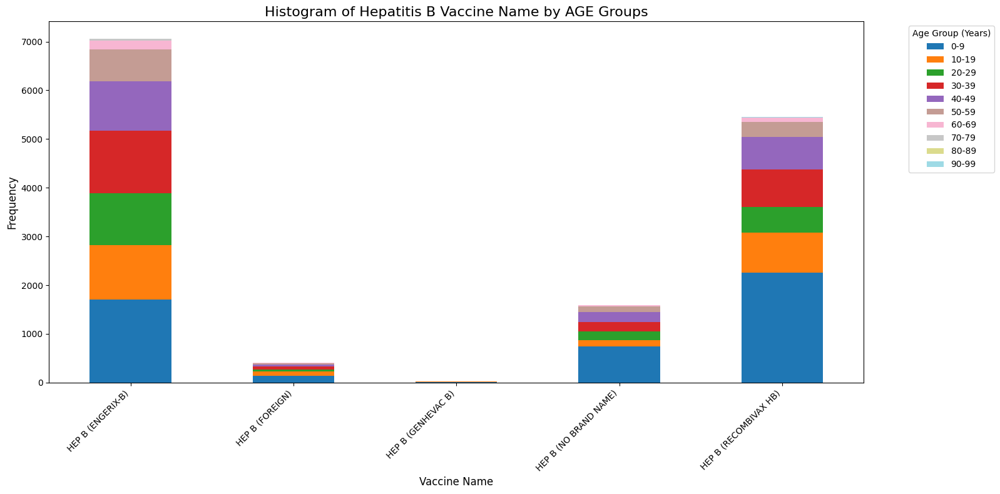

In [ ]:
import matplotlib.pyplot as plt
# Creating age bins
hepb_df_filtered = hepb_df_filtered.copy()
hepb_df_filtered['AGE_GROUP'] = pd.cut(
        hepb_df_filtered['AGE_YRS'], bins=range(0, 101, 10), right=False, labels=[f"{i}-{i+9}" for i in range(0, 100, 10)]
    )

# Group by Hepatits B vaccine name(VAX_NAME) and AGE group(AGE_GROUP)
age_vax_group = hepb_df_filtered.groupby(['VAX_NAME', 'AGE_GROUP'], observed=False).size().unstack(fill_value=0)
# Ploting the histogram
age_vax_group.plot(kind='bar', stacked=True, figsize=(14, 8), colormap='tab20')

# Adding titles and labels
plt.title('Histogram of Hepatitis B Vaccine Name by AGE Groups', fontsize=16)
plt.xlabel('Vaccine Name', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Showing the plot
plt.tight_layout()
plt.legend(title="Age Group (Years)", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [ ]:
#!pip install tabulate
table_markdown = age_vax_group.reset_index().to_markdown(index=False)
print("Markdown Table:\n")
print(table_markdown)

Markdown Table:

| VAX_NAME              |   0-9 |   10-19 |   20-29 |   30-39 |   40-49 |   50-59 |   60-69 |   70-79 |   80-89 |   90-99 |
|:----------------------|------:|--------:|--------:|--------:|--------:|--------:|--------:|--------:|--------:|--------:|
| HEP B (ENGERIX-B)     |  1699 |    1126 |    1066 |    1284 |    1006 |     655 |     185 |      35 |       4 |       0 |
| HEP B (FOREIGN)       |   144 |      79 |      45 |      63 |      42 |      23 |       9 |       1 |       0 |       0 |
| HEP B (GENHEVAC B)    |    17 |       1 |       0 |       1 |       1 |       2 |       0 |       0 |       0 |       0 |
| HEP B (NO BRAND NAME) |   745 |     127 |     173 |     193 |     211 |     118 |      19 |       5 |       2 |       0 |
| HEP B (RECOMBIVAX HB) |  2259 |     825 |     520 |     767 |     676 |     307 |      83 |       7 |       2 |       3 |


# Histogram of different of Hepatitis B Vaccienes adminstered based on Sex

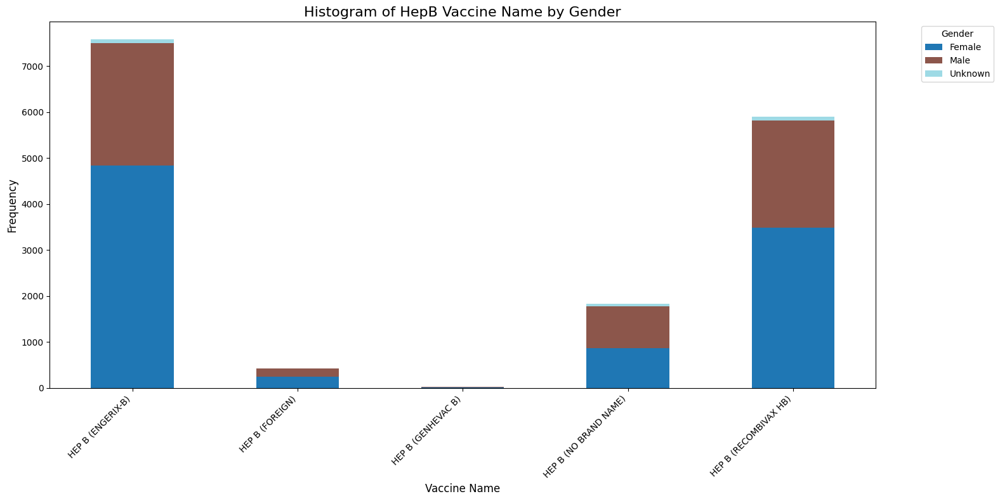

In [ ]:
gender_mapping = {'F': 'Female', 'M': 'Male', 'U': 'Unknown'}
vax_group = hepb_df_filtered.groupby(['VAX_NAME', 'SEX']).size().unstack(fill_value=0)
vax_group.rename(columns=gender_mapping, inplace=True)
vax_group.plot(kind='bar', stacked=True, figsize=(14, 8), colormap='tab20')
plt.title('Histogram of HepB Vaccine Name by Gender', fontsize=16)
plt.xlabel('Vaccine Name', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.legend(title="Gender", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [ ]:
markdown_table = vax_group.reset_index().to_markdown(index=False)
print("Frequency Table of Hepatits B Vaccine By Gender:\n")
print(markdown_table)

Frequency Table of Hepatits B Vaccine By Gender:

| VAX_NAME              |    F |    M |   U |
|:----------------------|-----:|-----:|----:|
| HEP B (ENGERIX-B)     | 2724 | 1542 |  47 |
| HEP B (FOREIGN)       |  177 |  145 |   2 |
| HEP B (GENHEVAC B)    |   10 |    7 |   0 |
| HEP B (NO BRAND NAME) |  467 |  560 |  23 |
| HEP B (RECOMBIVAX HB) | 2084 | 1394 |  53 |


# Histogram of different of Hepatitis B Vaccienes adminstered based on DIED after vaccination

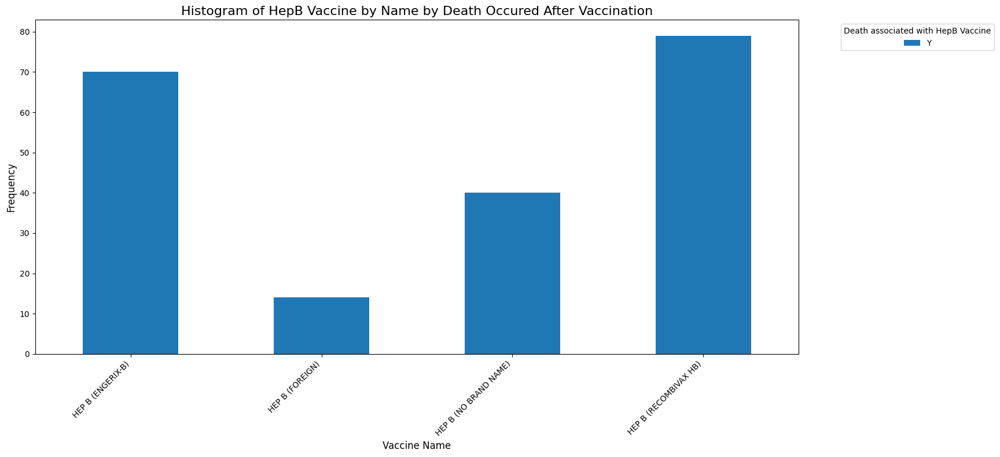

In [ ]:
vax_group = hepb_df_filtered.groupby(['VAX_NAME', 'DIED']).size().unstack(fill_value=0)
vax_group.plot(kind='bar', stacked=True, figsize=(14, 8), colormap='tab20')
plt.title('Histogram of HepB Vaccine by Name by Death Occured After Vaccination', fontsize=16)
plt.xlabel('Vaccine Name', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.legend(title="Death associated with HepB Vaccine", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [ ]:
markdown_table = vax_group.reset_index().to_markdown(index=False)
print("Frequency Table of HepB Vaccine by Name by Death Occured After Vaccination\n")
print(markdown_table)

Frequency Table of HepB Vaccine by Name by Death Occured After Vaccination

| VAX_NAME              |   Y |
|:----------------------|----:|
| HEP B (ENGERIX-B)     |  70 |
| HEP B (FOREIGN)       |  14 |
| HEP B (NO BRAND NAME) |  40 |
| HEP B (RECOMBIVAX HB) |  79 |


#Histogram of different of Hepatitis B Vaccienes adminstered based on Life threatning events associated with vaccination

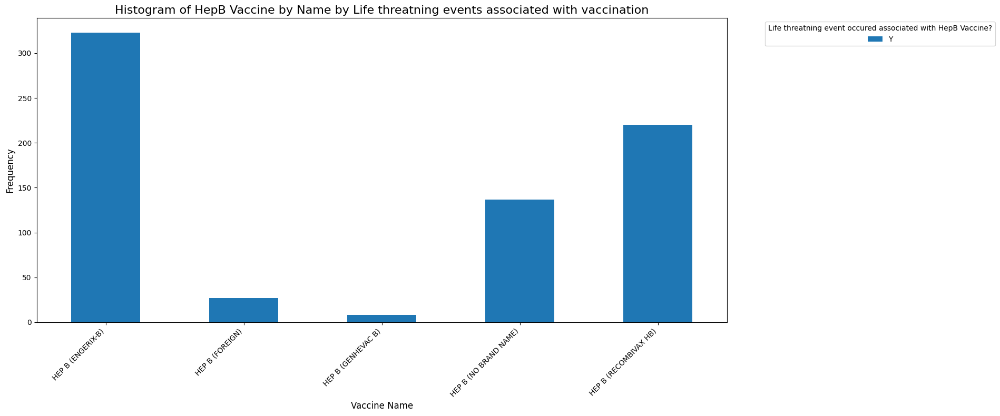

In [ ]:
vax_group = hepb_df_filtered.groupby(['VAX_NAME', 'L_THREAT']).size().unstack(fill_value=0)
vax_group.plot(kind='bar', stacked=True, figsize=(14, 8), colormap='tab20')
plt.title('Histogram of HepB Vaccine by Name by Life threatning events associated with vaccination', fontsize=16)
plt.xlabel('Vaccine Name', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.legend(title="Life threatning event occured associated with HepB Vaccine?", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [ ]:
markdown_table = vax_group.reset_index().to_markdown(index=False)
print("Frequency Table of HepB Vaccine by Name by Life threatning events associated with vaccination\n")
print(markdown_table)

Frequency Table of HepB Vaccine by Name by Life threatning events associated with vaccination

| VAX_NAME              |   Y |
|:----------------------|----:|
| HEP B (ENGERIX-B)     | 323 |
| HEP B (FOREIGN)       |  27 |
| HEP B (GENHEVAC B)    |   8 |
| HEP B (NO BRAND NAME) | 137 |
| HEP B (RECOMBIVAX HB) | 220 |


## Boxplot comparison of number of tokens in Symtoms text and Cleaned Symptoms text

In [ ]:
import matplotlib.pyplot as plt
hepb_df_filtered['SYMPTOM_TEXT_TOKENS'] = hepb_df_filtered['SYMPTOM_TEXT'].apply(lambda x: len(str(x).split()))
hepb_df_filtered['CLEANED_SYMPTOM_TEXT_TOKENS'] = hepb_df_filtered['CLEANED_SYMPTOM_TEXT'].apply(lambda x: len(str(x).split()))
symptom_text_summary = hepb_df_filtered['SYMPTOM_TEXT_TOKENS'].describe()[['min', '25%', '50%', '75%', 'max']]
cleaned_symptom_text_summary = hepb_df_filtered['CLEANED_SYMPTOM_TEXT_TOKENS'].describe()[['min', '25%', '50%', '75%', 'max']]
summary_df = pd.DataFrame({
        'Metric': ['Minimum', '1st Quartile (25%)', 'Median (50%)', '3rd Quartile (75%)', 'Maximum'],
        'SYMPTOM_TEXT': symptom_text_summary.values,
        'CLEANED_SYMPTOM_TEXT': cleaned_symptom_text_summary.values
    })
print(summary_df.to_markdown(index=False))

| Metric             |   SYMPTOM_TEXT |   CLEANED_SYMPTOM_TEXT |
|:-------------------|---------------:|-----------------------:|
| Minimum            |              1 |                      1 |
| 1st Quartile (25%) |             27 |                     19 |
| Median (50%)       |             39 |                     28 |
| 3rd Quartile (75%) |            111 |                     67 |
| Maximum            |           4695 |                   2808 |


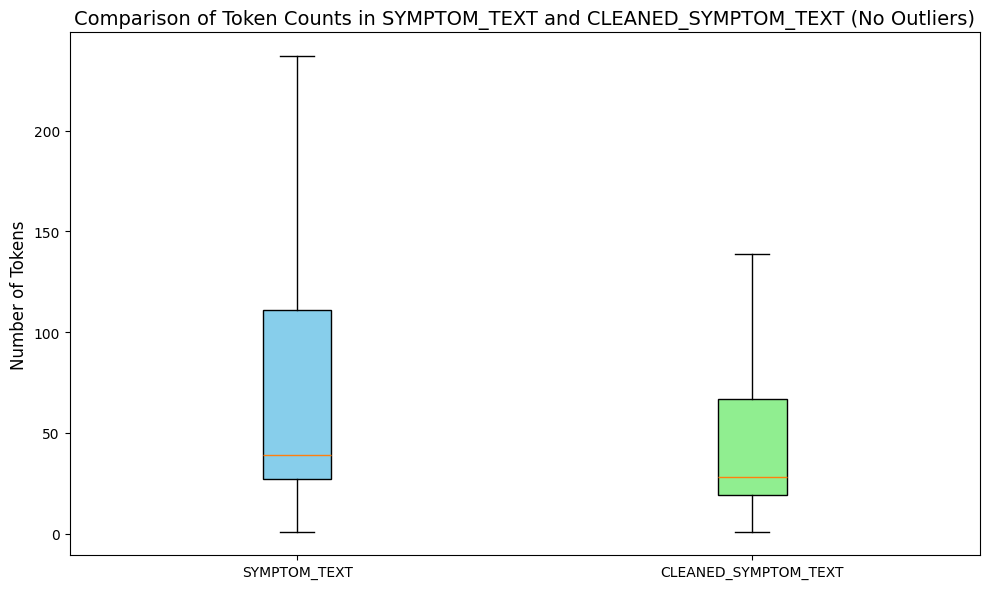

In [ ]:
plt.figure(figsize=(10, 6))
box = plt.boxplot(
        [
            hepb_df_filtered['SYMPTOM_TEXT_TOKENS'],
            hepb_df_filtered['CLEANED_SYMPTOM_TEXT_TOKENS']
        ],
        labels=['SYMPTOM_TEXT', 'CLEANED_SYMPTOM_TEXT'],
        patch_artist=True,
        showfliers=False  # Hide outliers
    )
colors = ['skyblue', 'lightgreen']
for patch, color in zip(box['boxes'], colors):
  patch.set_facecolor(color)

plt.title('Comparison of Token Counts in SYMPTOM_TEXT and CLEANED_SYMPTOM_TEXT (No Outliers)', fontsize=14)
plt.ylabel('Number of Tokens', fontsize=12)
plt.tight_layout()
plt.show()

## Top 10 Symptoms amongst the variables SYMPTOM1,...,SYMPTOM5:

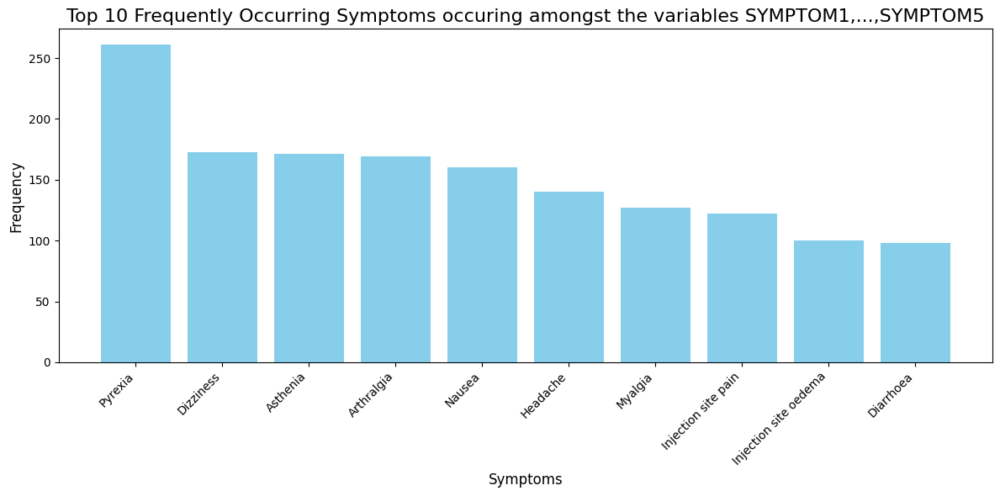

In [ ]:
import matplotlib.pyplot as plt
import ast
from collections import Counter
hepb_df_filtered['Symptom_List'] = hepb_df_filtered['Symptom_List'].apply(lambda x: ast.literal_eval(x) if isinstance(x, str) else x)
all_symptoms = [symptom for sublist in hepb_df_filtered['Symptom_List'] for symptom in sublist]
symptom_counts = Counter(all_symptoms)
# Get the top 10 most common symptoms
top_10_symptoms = symptom_counts.most_common(10)
symptoms, counts = zip(*top_10_symptoms)
# Create a histogram for the top 10 symptoms
plt.figure(figsize=(12, 6))
plt.bar(symptoms, counts, color='skyblue')
# Add titles and labels
plt.title('Top 10 Frequently Occurring Symptoms occuring amongst the variables SYMPTOM1,...,SYMPTOM5', fontsize=16)
plt.xlabel('Symptoms', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right')
# Show the plot
plt.tight_layout()
plt.show()


# TASK 1: Temporal Relationship Analysis of Symptoms

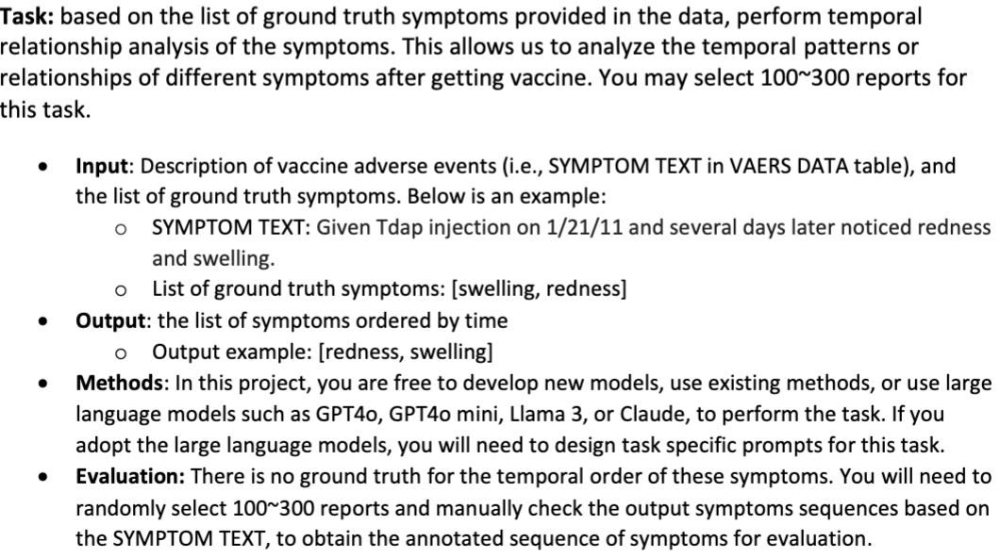
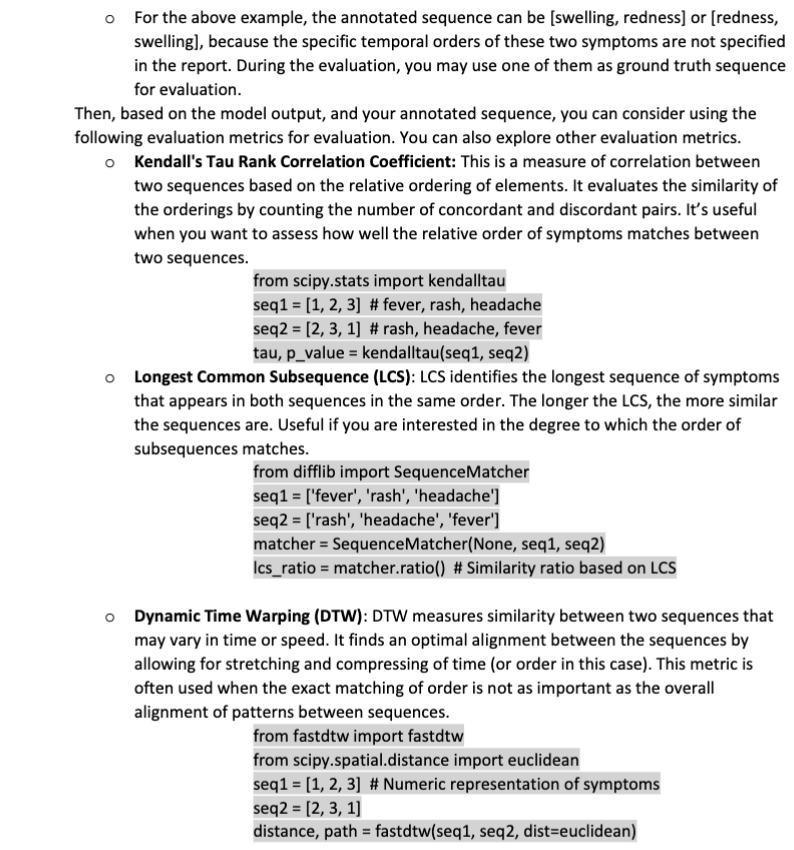

## Open AI GPT 4 Symptom Extraction:

In [ ]:
import openai
import pandas as pd
import numpy as np
from google.colab import userdata
import re
# Load OpenAI API key securely
openai.api_key = userdata.get('OPENAI_API_KEY')

# Token Limit Checker: Truncate input text to ensure it fits within GPT-4's token limit
def truncate_text(text, max_token_length=3000):
    if len(text) > max_token_length:
        return text[:max_token_length] + "..."
    return text

# Function to extract one-word symptoms
def extract_symptoms_gpt4(text):
    if not text or pd.isna(text):
        return []
    try:
        # Truncate text if too long
        text = truncate_text(text)

        # Enhanced prompt
        prompt = f"""
        Extract symptoms with at most 4 words for each symptom from the following text and return them as a Python list.
        Ensure the list contains unique symptoms and is in a format like ["symtom_1", "symptom_2",..., "symptom_n"]:
        Text: {text}
        """

        # Call GPT-4 API using ChatCompletion
        response = openai.ChatCompletion.create(
            model="gpt-4",
            messages=[
                {"role": "system", "content": "You are a helpful assistant for analyzing medical texts to extract a list of symtoms in the order they appear."},
                {"role": "user", "content": prompt}
            ],
            max_tokens=500,
            temperature=0.2
        )

        # Parse the response
        symptoms = response['choices'][0]['message']['content'].strip()

        # Evaluate the result to convert string representation of a list into a Python list
        symptoms_list = eval(symptoms) if symptoms.startswith("[") and symptoms.endswith("]") else []

        return symptoms_list
    except Exception as e:
        print(f"Error processing text: {text}\n{e}")
        return []



# Apply the function to the SYMPTOM_TEXT column
hepb_df_filtered["GPT4_SYMPTOMS"] = hepb_df_filtered["CLEANED_SYMPTOM_TEXT"].apply(extract_symptoms_gpt4)

# Save final results
final_save_path = "/content/GPT4_symptoms.csv"
os.makedirs(os.path.dirname(final_save_path), exist_ok=True)  # Ensure directory exists
hepb_df_filtered.to_csv(final_save_path, index=False)
print(f"Processing complete. Final results saved to {final_save_path}.")


In [ ]:
# Display the preprocessed text:
print_table = hepb_df_filtered[['SYMPTOM_TEXT', 'GPT4_SYMPTOMS']].head(20)

# Display the table-like structure
print(print_table)


                                         SYMPTOM_TEXT  \
0   Pt exp discomfort, warmth, edema around inject...   
1   SINCE 3-2-90 PT EXP STIFF NECK, FEVER, VOMITIN...   
2   SINCE 3-2-90 PT EXP STIFF NECK, FEVER, VOMITIN...   
3   2ND DOSE RECVD ON 3-30-90. 4-12-90 EXPERCD VOM...   
4   WITHIN 2 MIN OF VAX BECAME DIZZY, RAPID PULSE,...   
5   IMMEDIATELY AFTER IMMUN., ONSET OF FLUSHING, P...   
6   SAME DAY OF VAX, PT EXP ITCHING ALL DAY; 24 HR...   
7   PT EXP PAIN AT INJECT SITE. NOT ABLE TO SLEEP ...   
8   Pt received Engerix-B & experienced numbness i...   
9   Pt received Engerix-B and experienced chronic ...   
10  Pt received Engerix-B and experienced chronic ...   
11  ACHES, PAIN (JOINT), SWEATS, LOW GRADE TEMP, M...   
12  Pt vaccinated with Engerix-B developed dizzine...   
13  Pt vaccinated with ENGERIX-B developed headach...   
14  Pt vaccinated with Engerix-B developed headach...   
15  Pt received vax had that evening onset of chil...   
16  Pt received vax developed h

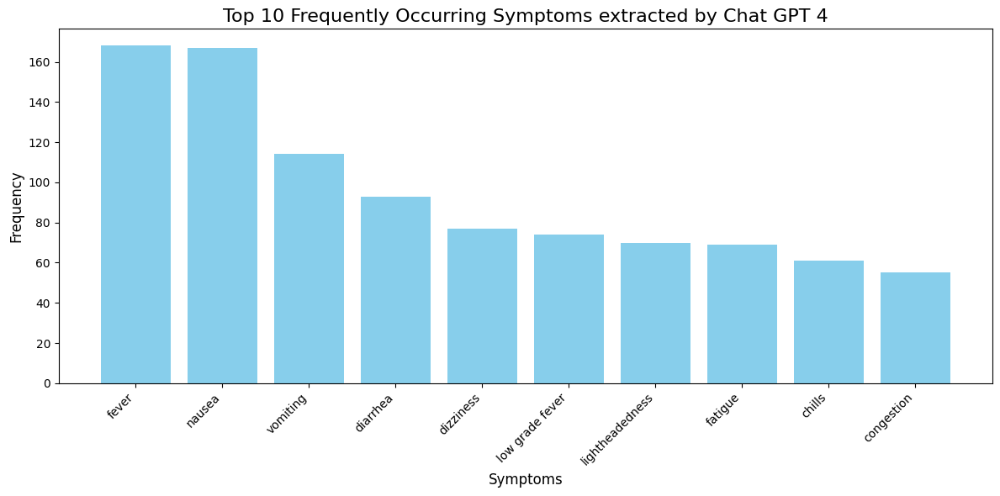

In [ ]:
import ast
from collections import Counter
import matplotlib.pyplot as plt

# Convert string representations of lists into actual lists
hepb_df_filtered['GPT4_SYMPTOMS'] = hepb_df_filtered['GPT4_SYMPTOMS'].apply(
    lambda x: ast.literal_eval(x) if isinstance(x, str) else x
)

# Flatten the list of symptoms
all_symptoms = [symptom for sublist in hepb_df_filtered['GPT4_SYMPTOMS'] for symptom in sublist]

# Count occurrences of each symptom
symptom_counts = Counter(all_symptoms)

# Get the top 10 most common symptoms
top_10_symptoms = symptom_counts.most_common(10)

# Unzip into separate lists
symptoms, counts = zip(*top_10_symptoms)

# Create a histogram for the top 10 symptoms
plt.figure(figsize=(12, 6))
plt.bar(symptoms, counts, color='skyblue')

# Add titles and labels
plt.title('Top 10 Frequently Occurring Symptoms extracted by Chat GPT 4', fontsize=16)
plt.xlabel('Symptoms', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.tight_layout()
plt.show()


## Antropic claude-3-5-sonnet-latest LLM Symptom Extraction:

In [ ]:
import anthropic
import pandas as pd
import os

# Set the API key for Anthropic's Claude API
api_key = "Antropic-API"
client = anthropic.Client(api_key=api_key)
# Function to extract symptoms using Claude 3.5 API
# Function to extract symptoms using Claude Messages API
def extract_symptoms_claude(text):
    if not text or pd.isna(text):
        return []
    try:
        # Truncate text if too long
        text = truncate_text(text)

        # Build the prompt
        prompt = f"""
        \n\nHuman: Extract a list of symptoms with at most 4 words for each symptom from the following text.
        Ensure the list is unique, well-formatted as a Python list, and follows this format: ["symptom_1", "symptom_2", ...].
        Symptoms should be extracted in the order they appear:
        Text: {text}
        \n\nAssistant:
        """

        # Send request to Claude Messages API
        response = client.messages.create(
            model="claude-3-5-sonnet-latest",
            messages=[{"content": prompt, "role": "user"}],
            max_tokens=500
        )

        result = response.content
        print(f"Raw model output: {result}\n")
        symptoms_list = result[0].text
        print(f"Extracted Symptoms: {symptoms_list}\n\n")
        return symptoms_list
    except Exception as e:
        print(f"Error processing text: {text}\n{e}")
        return []

# Apply the function to the SYMPTOM_TEXT column
hepb_df_filtered["Claude_SYMPTOMS"] = hepb_df_filtered["CLEANED_SYMPTOM_TEXT"].apply(extract_symptoms_claude)
save_file_path = "/content/drive/MyDrive/CS584_Project_GeneratedData/claude_symptoms.csv"


In [ ]:
import pandas as pd
hepb_df_filtered = pd.read_csv('/content/drive/MyDrive/CS584_Project_GeneratedData/claude_symptoms.csv')

In [ ]:
# Display the preprocessed text:
print_table = hepb_df_filtered[['SYMPTOM_TEXT', 'GPT4_SYMPTOMS', 'Claude_SYMPTOMS']].head(20)

# Display the table-like structure
print_table


,SYMPTOM_TEXT,GPT4_SYMPTOMS,Claude_SYMPTOMS
0,"Pt exp discomfort, warmth, edema around inject...","['discomfort', 'warmth', 'edema around inject ...","[""discomfort"", ""warmth"", ""edema around injecti..."
1,"SINCE 3-2-90 PT EXP STIFF NECK, FEVER, VOMITIN...","['stiff neck', 'fever', 'vomiting', 'sore thro...","[""stiff neck"", ""fever"", ""vomiting"", ""sore thro..."
2,"SINCE 3-2-90 PT EXP STIFF NECK, FEVER, VOMITIN...","['stiff neck', 'fever', 'vomiting', 'sore thro...","[""stiff neck"", ""fever"", ""vomiting"", ""sore thro..."
3,2ND DOSE RECVD ON 3-30-90. 4-12-90 EXPERCD VOM...,"['vomiting', 'diarrhea', 'elevated liver funct...","[""vomiting"", ""diarrhea"", ""elevated liver funct..."
4,"WITHIN 2 MIN OF VAX BECAME DIZZY, RAPID PULSE,...","['dizzy', 'rapid pulse', 'flushing', 'shallow ...",Here's the formatted list of unique symptoms i...
5,"IMMEDIATELY AFTER IMMUN., ONSET OF FLUSHING, P...","['onset flushing', 'profuse perspiration', 'sh...","[""immediate immune onset"", ""flushing"", ""profus..."
6,"SAME DAY OF VAX, PT EXP ITCHING ALL DAY; 24 HR...","['itching', 'nausea', 'cramps', 'watery diarrh...","[""itching"", ""nausea"", ""cramps"", ""watery diarrh..."
7,PT EXP PAIN AT INJECT SITE. NOT ABLE TO SLEEP ...,"['pain inject site', 'able sleep', 'pain', 'on...","[""pain inject site"", ""pain"", ""swelling"", ""heat..."
8,Pt received Engerix-B & experienced numbness i...,"['numbness lt leg', 'lt deltoid soreness', 'bi...","[""numbness left leg"", ""deltoid soreness"", ""bil..."
9,Pt received Engerix-B and experienced chronic ...,"['chronic fatigue syndrome', 'fever', 'unable ...","[""chronic fatigue syndrome"", ""fever"", ""unable ..."


In [ ]:
import ast
from collections import Counter
import matplotlib.pyplot as plt

def safe_literal_eval(val):
    """Safely evaluate a string to a Python object."""
    try:
        return ast.literal_eval(val) if isinstance(val, str) else val
    except (SyntaxError, ValueError):
        print(f"Skipping invalid entry: {val}")
        return []  # Return an empty list if the entry is invalid

# Apply the safe function
hepb_df_filtered['Claude_SYMPTOMS'] = hepb_df_filtered['Claude_SYMPTOMS'].apply(safe_literal_eval)

# Flatten the list of symptoms
all_symptoms = [symptom for sublist in hepb_df_filtered['Claude_SYMPTOMS'] for symptom in sublist]

# Count occurrences of each symptom
symptom_counts = Counter(all_symptoms)

# Get the top 10 most common symptoms
top_10_symptoms = symptom_counts.most_common(10)

# Unzip into separate lists
symptoms, counts = zip(*top_10_symptoms)

# Create a histogram for the top 10 symptoms
plt.figure(figsize=(12, 6))
plt.bar(symptoms, counts, color='skyblue')

# Add titles and labels
plt.title('Top 10 Frequently Occurring Symptoms extracted by Anthropic Claude 3.5 Sonnet Latest', fontsize=16)
plt.xlabel('Symptoms', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.tight_layout()
plt.show()


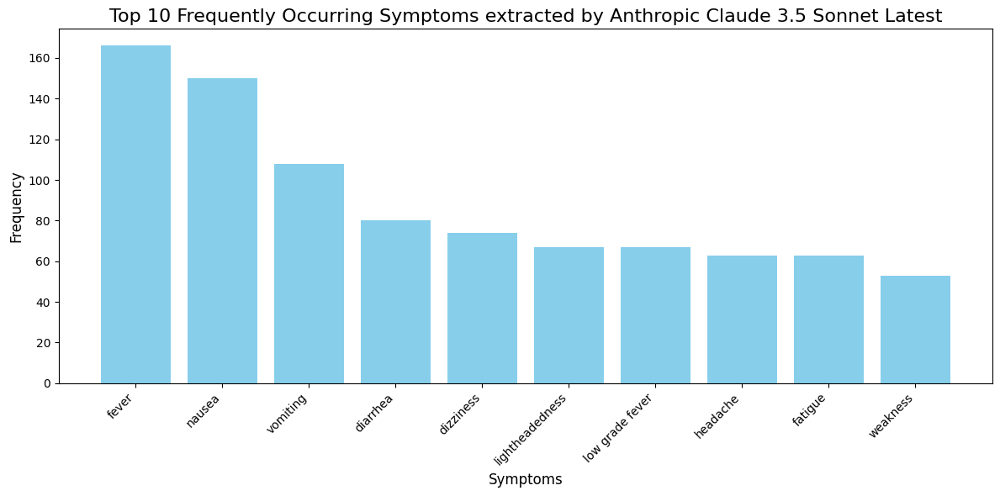

In [ ]:
# Unzip into separate lists
symptoms, counts = zip(*top_10_symptoms)

# Create a histogram for the top 10 symptoms
plt.figure(figsize=(12, 6))
plt.bar(symptoms, counts, color='skyblue')

# Add titles and labels
plt.title('Top 10 Frequently Occurring Symptoms extracted by Anthropic Claude 3.5 Sonnet Latest', fontsize=16)
plt.xlabel('Symptoms', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:
# Just in case the runtime fails
import pandas as pd
df = pd.read_csv("/content/drive/MyDrive/CS584_Project_GeneratedData/claude_symptoms.csv")


## Set of unique symptoms generated by Gpt 4

In [ ]:
# Function to safely evaluate string lists:
import ast
def safe_literal_eval(val):
    try:
        return ast.literal_eval(val) if isinstance(val, str) else val
    except (SyntaxError, ValueError):
        return []  # Return an empty list if the entry is invalid

# Convert GPT4_SYMPTOMS from string to list format
df['GPT4_SYMPTOMS'] = df['GPT4_SYMPTOMS'].apply(safe_literal_eval)

# Extract unique symptoms from GPT4_SYMPTOMS
gpt4_symptoms = set(symptom for sublist in df['GPT4_SYMPTOMS'] for symptom in sublist)
print(f"Number of unique symptoms generated by GPT4: {len(gpt4_symptoms)}")

# Print the unique symptoms
print("Unique Symptoms in GPT4_SYMPTOMS:")
sorted(gpt4_symptoms)[:10]

Number of unique symptoms generated by GPT4: 3185
Unique Symptoms in GPT4_SYMPTOMS:


['abd cramping',
 'abd cramping pain',
 'abd cramping rash knot',
 'abd cramps',
 'abd pain',
 'abdo cramping',
 'abdo cramps',
 'abdo pain',
 'abdo rash',
 'abdomen mainlyitchy']

In [ ]:
!pip install rapidfuzz

In [ ]:
import pandas as pd
import ast
from rapidfuzz import process, fuzz

# Function to group similar symptoms using fuzzy matching
def group_similar_symptoms(symptoms, threshold=90):
    grouped = {}  # Dictionary to store grouped symptoms

    for symptom in symptoms:
        if grouped:  # Ensure there are existing groups before calling extractOne
            result = process.extractOne(symptom, grouped.keys(), scorer=fuzz.partial_ratio)
            if result is not None:
                if len(result) == 3:  # If three values are returned
                    match, score, _ = result  # Extract only necessary values
                else:  # If two values are returned
                    match, score = result

                if score >= threshold:
                    grouped[match].append(symptom)
                    continue  # Skip adding a new group if a match was found

        # If no match or below threshold, create a new group
        grouped[symptom] = [symptom]

    return grouped

# Group symptoms with similarity threshold of 90%
grouped_symptoms_gpt4 = group_similar_symptoms(gpt4_symptoms)



## Set of unique symptoms generated by Claude Sonnet 3.5 model

In [ ]:
# Convert Claude_SYMPTOMS from string to list format
df['Claude_SYMPTOMS'] = df['Claude_SYMPTOMS'].apply(safe_literal_eval)

# Extract unique symptoms from Claude_SYMPTOMS
Claude_SYMPTOMS = set(symptom for sublist in df['Claude_SYMPTOMS'] for symptom in sublist)
print(f"Number of unique symptoms generated by Claude Sonnet 3.5: {len(Claude_SYMPTOMS)}")


In [ ]:
# Group symptoms with similarity threshold of 90%
grouped_symptoms_Claude3 = group_similar_symptoms(Claude_SYMPTOMS)


In [ ]:
# Creating a common dictionary from grouped_symptoms_gpt4 and grouped_symptoms_Claude3
merged_symptoms = {}
# Merge grouped_symptoms_gpt4 into merged_symptoms
for key, values in grouped_symptoms_gpt4.items():
    merged_symptoms[key] = set(values)
# Merge grouped_symptoms_Claude3, finding common keys and merging values
for key, values in grouped_symptoms_Claude3.items():
    result = process.extractOne(key, merged_symptoms.keys(), scorer=fuzz.partial_ratio) if merged_symptoms else None

    if result:
        match, score, *_ = result  # Correct unpacking
    else:
        match, score = None, 0

    if match and score >= 99.5:  # If a similar key exists in GPT4 group, merge values
        merged_symptoms[match].update(values)
    else:  # Otherwise, add it as a new key
        merged_symptoms[key] = set(values)

# Display the merged dictionary
# Convert dictionary to DataFrame
symptoms_Dict = pd.DataFrame(merged_symptoms.items(), columns=["Symptom", "Similar_Symptom_Representations"])

# Display the DataFrame
symptoms_Dict.head(10)

,Symptom,Similar_Symptom_Representations
0,unresponsive,"{unresponsive, unresponsiveness, unresponsive ..."
1,ringworm,{ringworm}
2,bright red diaper rash,"{rash, red, bright red diaper rash}"
3,elbow around l arm,"{elbow around l arm, elbow}"
4,rash on body,"{body, rash on body}"
5,circumoral edema,"{edema, circumoral edema}"
6,encephalographic,"{encephalographic, ha}"
7,faint flushing,"{faint, faint flushing, flu, flushing}"
8,tingling lt hand,"{tingling, tingling lt hand}"
9,full range motion,{full range motion}


This dictionary is manually modified to ensure that various representations of a symptom are correctly mapped to a unified key, accurately representing the symptom and maintaining consistency across different variations. This unified key of a symptom will replace the different representations of a symptom in the list of symptoms generated by GPT4 and Calude Sonnet 3.5 latest LLM.

In [ ]:
sympotoms_dict = symptoms_Dict.to_csv("/content/drive/MyDrive/CS584_Project_GeneratedData/symptoms_dict.csv")

I have used Chat GPT to replace the column in the **Symptom** with its most **Similar_Symptom_Representations** if necessary and have obtained a **updated_symptoms_dict.csv** which I will be using for further analysis.

In [ ]:
df[['GPT4_SYMPTOMS', 'Claude_SYMPTOMS']].tail()

,GPT4_SYMPTOMS,Claude_SYMPTOMS
948,"[low grade fever, light red rash, discomfort, ...","[low grade fever, light red rash, runny nose, ..."
949,"[extreme lethargy, headache, nausea, vomiting,...","[extreme lethargy, headache, nausea, vomiting,..."
950,"[grand mal seizure, head went back, eyes rolle...",[]
951,"[poor feeding, vomiting, lethargy, fever, susp...","[poor feeding, vomiting, lethargy, fever]"
952,"[flu symptoms, muscle aches, nauseous, fever, ...","[muscle aches, nauseous, fever, itching, rash,..."


Now let us replace the symptoms present in both **GPT4_SYMPTOMS** and **Calude_SYMPTOMS** with the **Symptom** so that the symptoms are represented uniformly in the list of symptoms extracted by both GPT4 and Claude 3.5 Sonnet LLMs.  

In [ ]:
# Reading the updated symptoms dictionary
symptoms_df = pd.read_csv("/content/drive/MyDrive/CS584_Project_GeneratedData/updated_symptoms_dict.csv")

# Convert the "Similar_Symptom_Representations" column to actual Python sets
symptoms_df["Similar_Symptom_Representations"] = symptoms_df["Similar_Symptom_Representations"].apply(ast.literal_eval)

# Create a mapping dictionary where each synonym maps to the standardized symptom name
symptom_mapping = {}
for _, row in symptoms_df.iterrows():
    standard_symptom = row["Symptom"]
    for synonym in row["Similar_Symptom_Representations"]:
        symptom_mapping[synonym] = standard_symptom

final = df[['GPT4_SYMPTOMS', 'Claude_SYMPTOMS']]
# Function to safely convert string representations of lists to actual lists
def safe_eval(symptoms):
    try:
        result = ast.literal_eval(symptoms) if isinstance(symptoms, str) else symptoms
        return result if isinstance(result, list) else []
    except (SyntaxError, ValueError):
        return []

# Applying the safe_eval funtion to the GPT4_SYMPTOMS and Claude_SYMPTOMS of the final dataframe.
final.loc[:, "GPT4_SYMPTOMS"] = final["GPT4_SYMPTOMS"].apply(safe_eval)
final.loc[:, "Claude_SYMPTOMS"] = final["Claude_SYMPTOMS"].apply(safe_eval)

# Function to replace a symptom in the symptom lists GPT4_SYMPTOMS or Claude_SYMPTOMS with a mapping from
# symptom dictionary
def replace_symptoms(symptoms_list):
    return [symptom_mapping.get(symptom, symptom) for symptom in symptoms_list]

# Applying the replace_symptoms to GPT4_SYMPTOMS or Claude_SYMPTOMS list of symptoms.
final.loc[:, "GPT4_SYMPTOMS"] = final["GPT4_SYMPTOMS"].apply(replace_symptoms)
final.loc[:, "Claude_SYMPTOMS"] = final["Claude_SYMPTOMS"].apply(replace_symptoms)

# Removing rows with missing values.
final_cleaned = final[
    (final["GPT4_SYMPTOMS"].apply(lambda x: len(x) > 0)) &
    (final["Claude_SYMPTOMS"].apply(lambda x: len(x) > 0))
]
final_cleaned.head(10)

,GPT4_SYMPTOMS,Claude_SYMPTOMS
0,"[rt, warmth, edema around inject site, muscle ...","[rt, warmth, edema around injection site, musc..."
1,"[stiff neck, low fever, vomit, sore throat, sw...","[stiff neck, low fever, vomit, sore throat, sw..."
2,"[stiff neck, low fever, vomit, sore throat, sw...","[stiff neck, low fever, vomit, sore throat, sw..."
3,"[vomit, nv diarrhea, elevated liver function t...","[vomit, nv diarrhea, elevated liver function t..."
5,"[onset flushing, profuse perspiration, sharp h...","[immediate immune onset, flushing face, profus..."
6,"[itching nose throat eyes, nauseated, severe s...","[itching nose throat eyes, nauseated, severe s..."
7,"[pain inject site, able sleep, pain in left fl...","[pain inject site, pain in left flank, swellin..."
8,"[numbness lt leg, lt deltoid soreness, rt, tin...","[numbness left leg, lt deltoid soreness, rt, t..."
9,"[chronic fatigue, low fever, able sleep, itchi...","[chronic fatigue, low fever, able sleep, itchi..."
10,"[chronic fatigue, low fever, able sleep, itchi...","[chronic fatigue, low fever, able sleep, itchi..."


In [ ]:
# Saving the final_cleaned dataframe as a csv file for further use:
final_cleaned.to_csv("/content/drive/MyDrive/CS584_Project_GeneratedData/final_cleaned_symptoms.csv")

In [ ]:
# Reading the final_cleaned_symptoms.csv incase the runtime is interrupted.
import pandas as pd
df = pd.read_csv("/content/drive/MyDrive/CS584_Project_GeneratedData/final_cleaned_symptoms.csv")

In [ ]:
import pandas as pd
from collections import Counter
from ast import literal_eval
import itertools
import matplotlib.pyplot as plt

def process_symptoms(column):
    """Convert string representations of lists into actual lists and extract symptoms."""
    processed_symptoms = []
    for symptoms in column.dropna():
        try:
            processed_symptoms.append(set(literal_eval(symptoms)))  # Convert to set for intersection
        except (SyntaxError, ValueError):
            continue
    return processed_symptoms

def get_common_sequences(gpt4_symptoms, claude_symptoms):
    """Find common symptom sequences in each record."""
    common_sequences = []
    for gpt4, claude in zip(gpt4_symptoms, claude_symptoms):
        common_symptoms = gpt4.intersection(claude)
        common_sequences.append(list(common_symptoms))
    return common_sequences


# Process symptoms columns
gpt4_symptoms = process_symptoms(df['GPT4_SYMPTOMS'])
claude_symptoms = process_symptoms(df['Claude_SYMPTOMS'])

# Get common symptom sequences
common_sequences = get_common_sequences(gpt4_symptoms, claude_symptoms)

# Count common sequences
common_counter = Counter(tuple(seq) for seq in common_sequences if seq)

# Convert to DataFrame
common_df = pd.DataFrame(common_counter.items(), columns=['Common Symptom Sequence', 'Frequency']).sort_values(by='Frequency', ascending=False)

common_df.head(10)

,Common Symptom Sequence,Frequency
171,"(lightheadedness, low grade, chilling joint pa...",48
275,"(vomit, severe dizziness, nauseated, muscle we...",9
176,"(lightheadedness, palpitations, pain inject si...",7
584,"(bed wetting, severe stomach pains, nauseated,...",4
79,"(rt,)",3
280,"(severe headaches, cold chills, muscle weaknes...",2
317,"(firmness, lt deltoid soreness, swelling nares...",2
273,"(pain inject site, pain elbow)",2
446,"(vomit, high pitched screaming)",2
8,"(residual joint aches, inflamed joints, chroni...",2


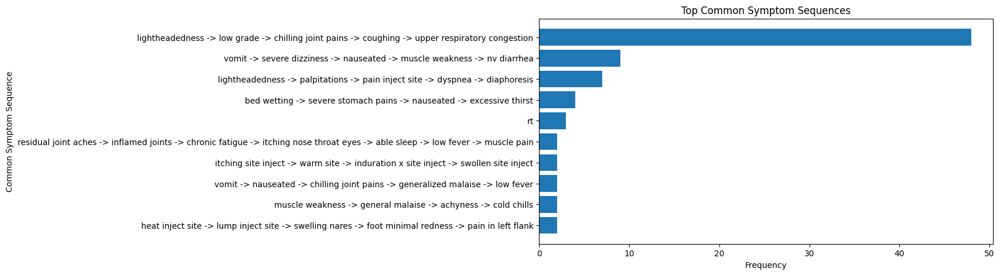

In [ ]:
# Plot the most common sequences
def plot_top_sequences(counter, title, top_n=10):
    sequences, counts = zip(*counter.most_common(top_n))
    sequences = [' -> '.join(seq) for seq in sequences]  # Convert tuple to string

    plt.figure(figsize=(10, 5))
    plt.barh(sequences[::-1], counts[::-1])  # Reverse for better visualization
    plt.xlabel("Frequency")
    plt.ylabel("Common Symptom Sequence")
    plt.title(title)
    plt.show()

# Plot the most common symptom sequences
plot_top_sequences(common_counter, "Top Common Symptom Sequences")




In [ ]:
# Save results
common_df.to_csv("/content/drive/MyDrive/CS584_Project_GeneratedData/Common_Symptom_Sequences.csv", index=False)

## Kendal Tau Rank Coefficient:

This is a measure of correlation between
two sequences based on the relative ordering of elements. It evaluates the similarity of
the orderings by counting the number of concordant and discordant pairs. It’s useful
when you want to assess how well the relative order of symptoms matches between
two sequences

In [ ]:
from scipy.stats import kendalltau
import pandas as pd


# Convert lists in the columns to ranks or comparable numerical values
# For example, you can use list lengths as a proxy, if needed:
df['GPT4_SYMPTOMS_LENGTH'] = df['GPT4_SYMPTOMS'].apply(len)
df['Claude_SYMPTOMS_LENGTH'] = df['Claude_SYMPTOMS'].apply(len)

# Compute Kendall Tau rank correlation
tau, p_value = kendalltau(df['GPT4_SYMPTOMS_LENGTH'], df['Claude_SYMPTOMS_LENGTH'])

# Display the results
print(f"Kendall Tau coefficient: {tau}")
print(f"P-value: {p_value}")


Kendall Tau coefficient: 0.6080003047956004
P-value: 2.6985838369921234e-136


In [ ]:
def get_rank_order(symptoms):
    return {symptom: rank for rank, symptom in enumerate(symptoms)}

# Align the rank orders for comparison
def compute_aligned_ranks(row):
    gpt4_ranks = get_rank_order(row['GPT4_SYMPTOMS'])
    claude_ranks = get_rank_order(row['Claude_SYMPTOMS'])

    # Find common symptoms
    common_symptoms = set(gpt4_ranks.keys()).intersection(set(claude_ranks.keys()))

    # Return aligned ranks
    return (
        [gpt4_ranks[symptom] for symptom in common_symptoms],
        [claude_ranks[symptom] for symptom in common_symptoms]
    )

# Apply the function and compute Kendall Tau
results = df.apply(compute_aligned_ranks, axis=1)
df['GPT4_RANKS'], df['Claude_RANKS'] = zip(*results)

# Calculate Kendall Tau for each row
df['Kendall_Tau'] = df.apply(lambda row: kendalltau(row['GPT4_RANKS'], row['Claude_RANKS'])[0] if row['GPT4_RANKS'] and row['Claude_RANKS'] else None, axis=1)

# Print
df[['GPT4_SYMPTOMS', 'Claude_SYMPTOMS', 'Kendall_Tau']].head(10)

,GPT4_SYMPTOMS,Claude_SYMPTOMS,Kendall_Tau
0,"['rt', 'warmth', 'edema around inject site', '...","['rt', 'warmth', 'edema around injection site'...",0.580952
1,"['stiff neck', 'low fever', 'vomit', 'sore thr...","['stiff neck', 'low fever', 'vomit', 'sore thr...",0.927536
2,"['stiff neck', 'low fever', 'vomit', 'sore thr...","['stiff neck', 'low fever', 'vomit', 'sore thr...",1.000000
3,"['vomit', 'nv diarrhea', 'elevated liver funct...","['vomit', 'nv diarrhea', 'elevated liver funct...",1.000000
4,"['onset flushing', 'profuse perspiration', 'sh...","['immediate immune onset', 'flushing face', 'p...",1.000000
5,"['itching nose throat eyes', 'nauseated', 'sev...","['itching nose throat eyes', 'nauseated', 'sev...",1.000000
6,"['pain inject site', 'able sleep', 'pain in le...","['pain inject site', 'pain in left flank', 'sw...",0.960000
7,"['numbness lt leg', 'lt deltoid soreness', 'rt...","['numbness left leg', 'lt deltoid soreness', '...",1.000000
8,"['chronic fatigue', 'low fever', 'able sleep',...","['chronic fatigue', 'low fever', 'able sleep',...",0.982906
9,"['chronic fatigue', 'low fever', 'able sleep',...","['chronic fatigue', 'low fever', 'able sleep',...",0.982906


Five-Point Summary:
Minimum: 0.08571428571428572
1st Quartile (Q1): 0.7914737436476568
Median (Q2): 0.9894736842105263
3rd Quartile (Q3): 1.0
Maximum: 1.0


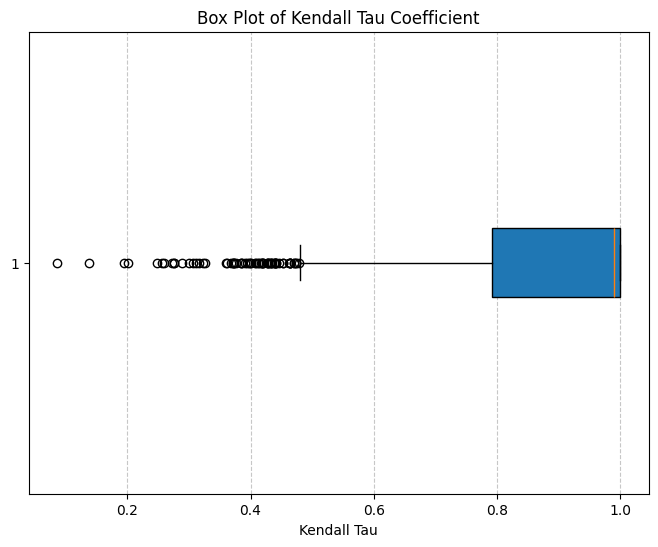

In [ ]:
import matplotlib.pyplot as plt
# Drop missing values in Kendall_Tau column
kendall_tau_values = df['Kendall_Tau'].dropna()

# Five-point summary
five_point_summary = {
    "Minimum": kendall_tau_values.min(),
    "1st Quartile (Q1)": kendall_tau_values.quantile(0.25),
    "Median (Q2)": kendall_tau_values.median(),
    "3rd Quartile (Q3)": kendall_tau_values.quantile(0.75),
    "Maximum": kendall_tau_values.max(),
}

# Print the five-point summary
print("Five-Point Summary:")
for key, value in five_point_summary.items():
    print(f"{key}: {value}")

# Generate a box plot
plt.figure(figsize=(8, 6))
plt.boxplot(kendall_tau_values, vert=False, patch_artist=True)
plt.title('Box Plot of Kendall Tau Coefficient')
plt.xlabel('Kendall Tau')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

 **We notice that there are a lot of outliers on the left side(values between 0.0 and 0.5). These outliers indicate cases where Kendall Tau values deviate significantly, suggesting a weaker correlation in some instances. The *Inter Quartile Range* ranges between 0.75 to 1.0, indicating that 50% of the data falls within this range.
A high median (close to 0.9) indicates that, in most cases, the ranking sequences generated by GPT-4 and Claude 3.5 Sonnet are highly correlated.<br>
The high agreement (upper quartile near 1.0) suggests that GPT-4 and Claude 3.5 Sonnet often provide similar orderings.<br>
The outliers at the lower end may indicate scenarios where rankings diverged significantly, possibly due to ambiguous symptoms, model biases, or dataset inconsistencies.**<br>

## Longest Common Subsequence (LCS):

LCS identifies the longest sequence of symptoms
that appears in both sequences in the same order. The longer the LCS, the more similar
the sequences are. Useful if you are interested in the degree to which the order of
subsequences matches.

In [ ]:
# Function to calculate LCS ratio:
from difflib import SequenceMatcher
def calculate_lcs_ratio(seq1, seq2):
    matcher = SequenceMatcher(None, seq1, seq2)
    lcs_ratio = matcher.ratio()
    return lcs_ratio

# Iterate over rows in the dataframe and calculate LCS ratio
df['LCS_Ratio'] = df.apply(lambda row: calculate_lcs_ratio(row['GPT4_SYMPTOMS'], row['Claude_SYMPTOMS']), axis=1)

# Display the LCS results
df[['GPT4_SYMPTOMS', 'Claude_SYMPTOMS', 'LCS_Ratio']].head(10)

,GPT4_SYMPTOMS,Claude_SYMPTOMS,LCS_Ratio
0,"['rt', 'warmth', 'edema around inject site', '...","['rt', 'warmth', 'edema around injection site'...",0.862745
1,"['stiff neck', 'low fever', 'vomit', 'sore thr...","['stiff neck', 'low fever', 'vomit', 'sore thr...",0.927374
2,"['stiff neck', 'low fever', 'vomit', 'sore thr...","['stiff neck', 'low fever', 'vomit', 'sore thr...",1.000000
3,"['vomit', 'nv diarrhea', 'elevated liver funct...","['vomit', 'nv diarrhea', 'elevated liver funct...",1.000000
4,"['onset flushing', 'profuse perspiration', 'sh...","['immediate immune onset', 'flushing face', 'p...",0.878049
5,"['itching nose throat eyes', 'nauseated', 'sev...","['itching nose throat eyes', 'nauseated', 'sev...",1.000000
6,"['pain inject site', 'able sleep', 'pain in le...","['pain inject site', 'pain in left flank', 'sw...",0.754098
7,"['numbness lt leg', 'lt deltoid soreness', 'rt...","['numbness left leg', 'lt deltoid soreness', '...",0.980583
8,"['chronic fatigue', 'low fever', 'able sleep',...","['chronic fatigue', 'low fever', 'able sleep',...",0.919861
9,"['chronic fatigue', 'low fever', 'able sleep',...","['chronic fatigue', 'low fever', 'able sleep',...",0.919861


Five-Point Summary:
Minimum: 0.08144796380090498
1st Quartile (Q1): 0.8062713339133927
Median (Q2): 0.9053678973553286
3rd Quartile (Q3): 1.0
Maximum: 1.0


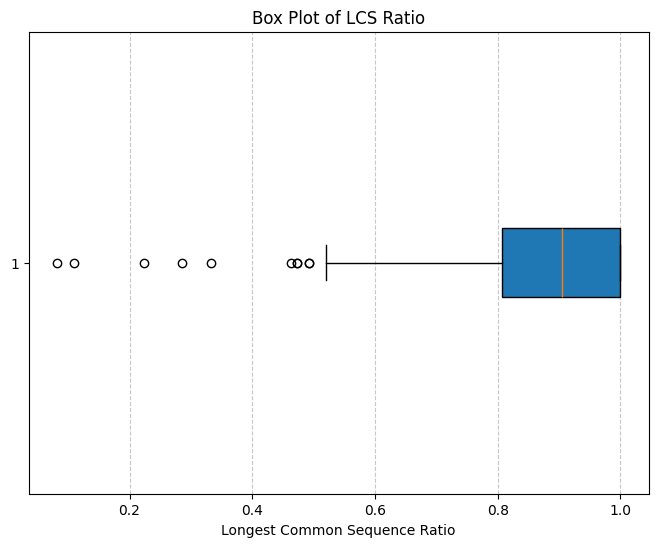

In [ ]:
import matplotlib.pyplot as plt
# Drop missing values in Kendall_Tau column
LCS_values = df['LCS_Ratio'].dropna()

# Five-point summary
five_point_summary = {
    "Minimum": LCS_values.min(),
    "1st Quartile (Q1)": LCS_values.quantile(0.25),
    "Median (Q2)": LCS_values.median(),
    "3rd Quartile (Q3)": LCS_values.quantile(0.75),
    "Maximum": LCS_values.max(),
}

# Print the five-point summary
print("Five-Point Summary:")
for key, value in five_point_summary.items():
    print(f"{key}: {value}")

# Generate a box plot
plt.figure(figsize=(8, 6))
plt.boxplot(LCS_values, vert=False, patch_artist=True)
plt.title('Box Plot of LCS Ratio')
plt.xlabel('Longest Common Sequence Ratio')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

In [ ]:
# Filter rows where both LCS_Ratio and Kendall_Tau are greater than 0.9
filtered_df = df[(df['LCS_Ratio'] > 0.96) & (df['Kendall_Tau'] > 0.9)]

# Display the filtered DataFrame
print(filtered_df.shape)
print(filtered_df.columns)

(270, 8)
Index(['GPT4_SYMPTOMS', 'Claude_SYMPTOMS', 'GPT4_SYMPTOMS_LENGTH',
       'Claude_SYMPTOMS_LENGTH', 'GPT4_RANKS', 'Claude_RANKS', 'Kendall_Tau',
       'LCS_Ratio'],
      dtype='object')


## Dynamic Time Warping (DTW):

DTW measures similarity between two sequences that
may vary in time or speed. It finds an optimal alignment between the sequences by
allowing for stretching and compressing of time (or order in this case). This metric is
often used when the exact matching of order is not as important as the overall
alignment of patterns between sequences.



In [ ]:
# Custom function to handle both lists and strings
def parse_symptom_list(symptom_data):
    if isinstance(symptom_data, list):
        # If it's already a list, return it as-is
        return symptom_data
    elif isinstance(symptom_data, str):
        # If it's a string, convert it to a list
        symptom_list = symptom_data.strip("[]").split(",")
        # Clean up whitespace and quotes around each symptom
        return [item.strip().strip("'").strip('"') for item in symptom_list]
    else:
        # If it's something else, return an empty list (or handle it as needed)
        return []

filtered_df = filtered_df.copy()

filtered_df['GPT4_SYMPTOMS'] = filtered_df['GPT4_SYMPTOMS'].apply(parse_symptom_list)
filtered_df['Claude_SYMPTOMS'] = filtered_df['Claude_SYMPTOMS'].apply(parse_symptom_list)


In [ ]:
# Performing encoding of symptoms:
filtered_df[['GPT4_SYMPTOMS', 'Claude_SYMPTOMS']].head()


,GPT4_SYMPTOMS,Claude_SYMPTOMS
2,"[stiff neck, low fever, vomit, sore throat, sw...","[stiff neck, low fever, vomit, sore throat, sw..."
3,"[vomit, nv diarrhea, elevated liver function t...","[vomit, nv diarrhea, elevated liver function t..."
5,"[itching nose throat eyes, nauseated, severe s...","[itching nose throat eyes, nauseated, severe s..."
7,"[numbness lt leg, lt deltoid soreness, rt, tin...","[numbness left leg, lt deltoid soreness, rt, t..."
11,"[severe dizziness, viral exanthema, severe hea...","[severe dizziness, viral exanthema, severe hea..."


In [ ]:
# Performing Encoding:
from sklearn.preprocessing import LabelEncoder

# Combine all symptoms for consistent encoding
all_symptoms = list(
    set(
        sum(filtered_df['GPT4_SYMPTOMS'].tolist() + filtered_df['Claude_SYMPTOMS'].tolist(), [])
    )
)

# Fit the LabelEncoder
encoder = LabelEncoder()
encoder.fit(all_symptoms)

# Encode symptoms in both columns as numerical lists
filtered_df['GPT4_SYMPTOMS_NUM'] = filtered_df['GPT4_SYMPTOMS'].apply(lambda x: encoder.transform(x).tolist())
filtered_df['Claude_SYMPTOMS_NUM'] = filtered_df['Claude_SYMPTOMS'].apply(lambda x: encoder.transform(x).tolist())

# Display the result
filtered_df[['GPT4_SYMPTOMS', 'Claude_SYMPTOMS', 'GPT4_SYMPTOMS_NUM', 'Claude_SYMPTOMS_NUM']].head()


,GPT4_SYMPTOMS,Claude_SYMPTOMS,GPT4_SYMPTOMS_NUM,Claude_SYMPTOMS_NUM
2,"[stiff neck, low fever, vomit, sore throat, sw...","[stiff neck, low fever, vomit, sore throat, sw...","[400, 241, 463, 395, 419, 284, 147]","[400, 241, 463, 395, 419, 284, 147]"
3,"[vomit, nv diarrhea, elevated liver function t...","[vomit, nv diarrhea, elevated liver function t...","[463, 279, 99, 386]","[463, 279, 99, 386]"
5,"[itching nose throat eyes, nauseated, severe s...","[itching nose throat eyes, nauseated, severe s...","[212, 267, 369, 467, 468, 352]","[212, 267, 369, 467, 468, 352]"
7,"[numbness lt leg, lt deltoid soreness, rt, tin...","[numbness left leg, lt deltoid soreness, rt, t...","[277, 244, 345, 438, 260]","[275, 244, 345, 437, 260]"
11,"[severe dizziness, viral exanthema, severe hea...","[severe dizziness, viral exanthema, severe hea...","[360, 461, 364, 67, 364, 240, 142, 64, 241]","[360, 461, 364, 67, 364, 240, 142, 64, 241]"


In [ ]:
import numpy as np
import pandas as pd

# Function to calculate DTW distance and path
def dtw_distance_with_path(series1, series2):
    n, m = len(series1), len(series2)
    dtw_matrix = np.zeros((n + 1, m + 1)) + np.inf
    dtw_matrix[0, 0] = 0

    # Fill the DTW matrix
    for i in range(1, n + 1):
        for j in range(1, m + 1):
            cost = abs(series1[i - 1] - series2[j - 1])  # Euclidean distance
            dtw_matrix[i, j] = cost + min(
                dtw_matrix[i - 1, j],    # Insertion
                dtw_matrix[i, j - 1],    # Deletion
                dtw_matrix[i - 1, j - 1] # Match
            )

    # Backtrack to find the optimal path
    i, j = n, m
    path = []
    while i > 0 or j > 0:
        path.append((i - 1, j - 1))  # Adjust for 0-based indexing
        if i == 0:
            j -= 1
        elif j == 0:
            i -= 1
        else:
            steps = [
                dtw_matrix[i - 1, j],    # Insertion
                dtw_matrix[i, j - 1],    # Deletion
                dtw_matrix[i - 1, j - 1] # Match
            ]
            min_step = np.argmin(steps)
            if min_step == 0:  # Insertion
                i -= 1
            elif min_step == 1:  # Deletion
                j -= 1
            else:  # Match
                i -= 1
                j -= 1

    path.reverse()  # Reverse to start from (0, 0)
    return dtw_matrix[n, m], path

# Map DTW path indices to symptom names
def map_path_to_symptoms(path, series1, series2):
    symptom_path = [(series1[i] if i >= 0 else None, series2[j] if j >= 0 else None) for i, j in path]
    return symptom_path

# Example DataFrame (filtered_df with symptoms as strings)
filtered_df['DTW_Result'] = filtered_df.apply(
    lambda row: dtw_distance_with_path(row['GPT4_SYMPTOMS_NUM'], row['Claude_SYMPTOMS_NUM']),
    axis=1
)

# Extract DTW distance and path
filtered_df['DTW_Distance'] = filtered_df['DTW_Result'].apply(lambda x: x[0])
filtered_df['DTW_Path_Indices'] = filtered_df['DTW_Result'].apply(lambda x: x[1])

# Map path indices to actual symptom names
filtered_df['DTW_Path_Symptoms'] = filtered_df.apply(
    lambda row: map_path_to_symptoms(row['DTW_Path_Indices'], row['GPT4_SYMPTOMS'], row['Claude_SYMPTOMS']),
    axis=1
)

# Display the result
filtered_df[['GPT4_SYMPTOMS', 'Claude_SYMPTOMS', 'DTW_Path_Symptoms', 'DTW_Distance']]


,GPT4_SYMPTOMS,Claude_SYMPTOMS,DTW_Path_Symptoms,DTW_Distance
2,"[stiff neck, low fever, vomit, sore throat, sw...","[stiff neck, low fever, vomit, sore throat, sw...","[(stiff neck, stiff neck), (low fever, low fev...",0.0
3,"[vomit, nv diarrhea, elevated liver function t...","[vomit, nv diarrhea, elevated liver function t...","[(vomit, vomit), (nv diarrhea, nv diarrhea), (...",0.0
5,"[itching nose throat eyes, nauseated, severe s...","[itching nose throat eyes, nauseated, severe s...","[(itching nose throat eyes, itching nose throa...",0.0
7,"[numbness lt leg, lt deltoid soreness, rt, tin...","[numbness left leg, lt deltoid soreness, rt, t...","[(numbness lt leg, numbness left leg), (lt del...",3.0
11,"[severe dizziness, viral exanthema, severe hea...","[severe dizziness, viral exanthema, severe hea...","[(severe dizziness, severe dizziness), (viral ...",0.0
...,...,...,...,...
754,"[severe headaches, chronic fatigue, nauseated,...","[severe headaches, chronic fatigue, nauseated,...","[(severe headaches, severe headaches), (chroni...",0.0
755,"[muscle weakness, progressive pallor upper bod...","[muscle weakness, progressive pallor upper bod...","[(muscle weakness, muscle weakness), (progress...",0.0
756,"[severe headaches, severe dizziness, low fever...","[severe headaches, severe dizziness, low fever...","[(severe headaches, severe headaches), (severe...",0.0
758,"[impaired memorycognition, constant headache, ...","[impaired memory cognition, constant headache,...","[(impaired memorycognition, impaired memory co...",282.0


Five-Point Summary Of DTW Distance:
Minimum: 0.0
1st Quartile (Q1): 0.0
Median (Q2): 0.0
3rd Quartile (Q3): 0.0
Maximum: 282.0


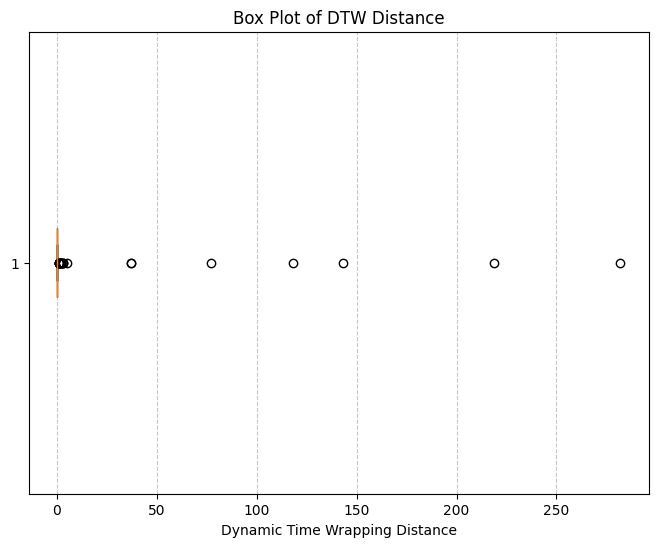

In [ ]:
# Drop missing values in Kendall_Tau column
DTW_Distance = filtered_df['DTW_Distance'].dropna()

# Five-point summary
five_point_summary = {
    "Minimum": DTW_Distance.min(),
    "1st Quartile (Q1)": DTW_Distance.quantile(0.25),
    "Median (Q2)": DTW_Distance.median(),
    "3rd Quartile (Q3)": DTW_Distance.quantile(0.75),
    "Maximum": DTW_Distance.max(),
}

# Print the five-point summary
print("Five-Point Summary Of DTW Distance:")
for key, value in five_point_summary.items():
    print(f"{key}: {value}")

# Generate a box plot
plt.figure(figsize=(8, 6))
plt.boxplot(DTW_Distance, vert=False, patch_artist=True)
plt.title('Box Plot of DTW Distance')
plt.xlabel('Dynamic Time Wrapping Distance')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

In [ ]:
# Save the DataFrame as a .csv file
filtered_df.to_csv("/content/drive/MyDrive/CS584_Project_GeneratedData/final_filtered_df.csv", index=False)

print("DataFrame saved as 'filtered_df.csv'")


DataFrame saved as 'filtered_df.csv'


In [ ]:
import pandas as pd
filtered_df = pd.read_csv("/content/drive/MyDrive/CS584_Project_GeneratedData/final_filtered_df.csv")

# TASK 2: Associative Relationship Analysis of Symptoms

In [ ]:
!pip install --upgrade mlxtend



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 9.2 MB/s eta 0:00:00


In [ ]:
filtered_df['GPT4_SYMPTOMS'].head()

,GPT4_SYMPTOMS
0,"['stiff neck', 'low fever', 'vomit', 'sore thr..."
1,"['vomit', 'nv diarrhea', 'elevated liver funct..."
2,"['itching nose throat eyes', 'nauseated', 'sev..."
3,"['numbness lt leg', 'lt deltoid soreness', 'rt..."
4,"['severe dizziness', 'viral exanthema', 'sever..."


In [ ]:
print(type(filtered_df['GPT4_SYMPTOMS'].iloc[0]))

<class 'str'>


In [ ]:
import ast

filtered_df['GPT4_SYMPTOMS'] = filtered_df['GPT4_SYMPTOMS'].apply(ast.literal_eval)


In [ ]:
# Function to one-hot encode symptoms
def one_hot_encode_symptoms(row, all_symptoms):
    return {symptom: (symptom in row) for symptom in all_symptoms}
# Step 1: Create the list of unique symptoms
all_symptoms = sorted(set(symptom for symptoms in filtered_df['GPT4_SYMPTOMS'] for symptom in symptoms))

# Step 2: One-hot encode the symptoms
transaction_data = filtered_df['GPT4_SYMPTOMS'].apply(lambda x: one_hot_encode_symptoms(x, all_symptoms))
transaction_df = pd.DataFrame(transaction_data.tolist(), columns=all_symptoms).fillna(False).astype(bool)

# Step 3: Verify the output
print("Transaction DataFrame Sample:")
transaction_df.head()


Transaction DataFrame Sample:


,abd cramping pain,abd pain,abdo cramping,abdo cramps,abdo rash,abdominal cramping,abdominal pain,abnormal coloring,abnormal eeg,aches pains inject site,...,weakness muscles,weight loss,weird taste mouth,weltlike rash,went shock,wheeze heard chest,wheezes,wheezing voice,white lips,wrists sides torso axilla
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [ ]:
!pip install mlxtend==0.20.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 9.2 MB/s eta 0:00:00
  Attempting uninstall: mlxtend
    Found existing installation: mlxtend 0.23.4
    Uninstalling mlxtend-0.23.4:
      Successfully uninstalled mlxtend-0.23.4


In [ ]:
import mlxtend
print(mlxtend.__version__)


0.20.0


In [ ]:
from mlxtend.frequent_patterns import apriori, association_rules
import pandas as pd

# Step 1: Generate frequent itemsets
min_support_value = 0.03
frequent_itemsets = apriori(transaction_df, min_support=min_support_value, use_colnames=True)

# Step 2: Check if frequent itemsets are generated
if frequent_itemsets.empty:
    print("No frequent itemsets found. Try lowering the min_support value.")
else:
    # Sort frequent itemsets by support in descending order
    frequent_itemsets_support = frequent_itemsets.sort_values(by='support', ascending=False)

    print("\nTop 15 Frequent Itemsets Found (Sorted by Support Descending):")
    print(frequent_itemsets_support[:15].to_string(index=False))


# Step 3: Generate association rules
try:
    rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1.0)

    # Selecting specific columns for display
    columns_to_display = ['antecedents', 'consequents', 'support', 'confidence', 'lift']

    # Sorting and displaying top 15 rules separately
    print("\nTop 15 Association Rules (Sorted by Lift - Descending):")
    print(rules.sort_values(by='lift', ascending=False).head(15)[columns_to_display].to_string(index=False))

    print("\nTop 15 Association Rules (Sorted by Confidence - Descending):")
    print(rules.sort_values(by='confidence', ascending=False).head(15)[columns_to_display].to_string(index=False))

    print("\nTop 15 Association Rules (Sorted by Support - Descending):")
    print(rules.sort_values(by='support', ascending=False).head(15)[columns_to_display].to_string(index=False))

except Exception as e:
    print(f"Error in generating rules: {e}")
    print("Ensure you have the latest version of mlxtend installed.")



Top 15 Frequent Itemsets Found (Sorted by Support Descending):
 support                                                                                   itemsets
0.274074                                                                                (nauseated)
0.233333                                                                          (lightheadedness)
0.225926                                                                     (chilling joint pains)
0.218519                                                                                    (vomit)
0.211111                                                                                (low fever)
0.203704                                                                                (low grade)
0.200000                                                                                 (coughing)
0.181481                                                           (coughing, chilling joint pains)
0.181481                            

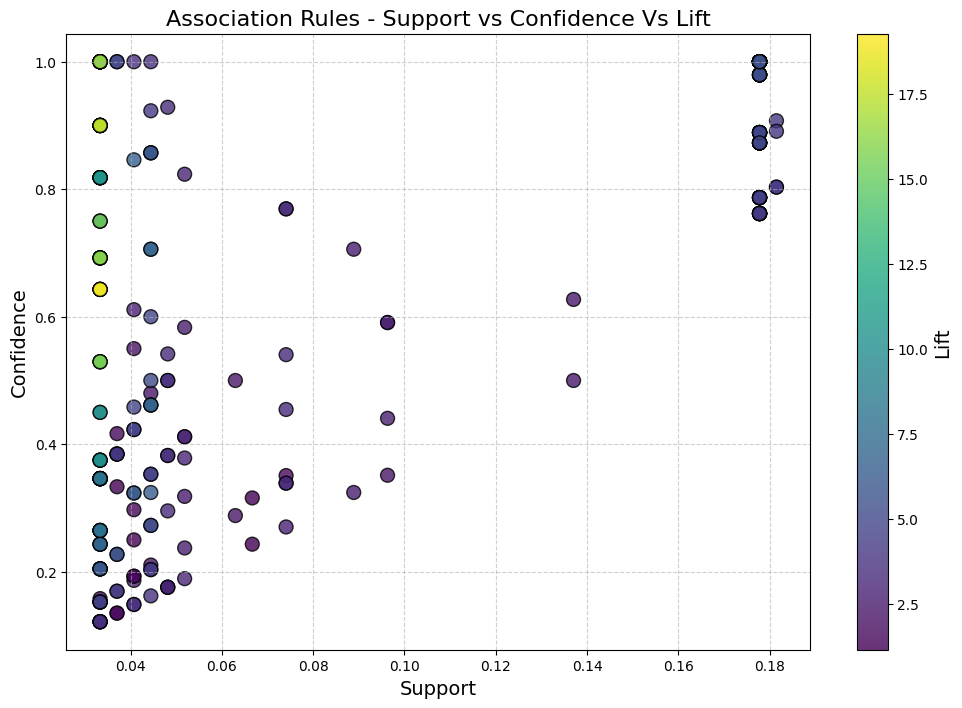

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

try:
    rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1.0)

    # Extract necessary data for plotting
    support = rules['support']
    confidence = rules['confidence']
    lift = rules['lift']

    # Create the plot
    plt.figure(figsize=(12, 8))
    scatter = plt.scatter(support, confidence, c=lift, cmap='viridis', s=100, alpha=0.8, edgecolor='k')
    plt.title('Association Rules - Support vs Confidence Vs Lift', fontsize=16)
    plt.xlabel('Support', fontsize=14)
    plt.ylabel('Confidence', fontsize=14)

    # Add colorbar for Lift
    cbar = plt.colorbar(scatter)
    cbar.set_label('Lift', fontsize=14)

    # Show grid
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()

except Exception as e:
    print(f"Error in generating or plotting rules: {e}")


# **Interpretation of the Scatter Plot**

The scatter plot visualizes the association rules generated using the **Apriori algorithm** on symptoms **post Hepatitis B vaccination** based on three key measures:  
- **Support (X-axis)**: Frequency of the symptom combinations in the dataset.  
- **Confidence (Y-axis)**: How likely a symptom (consequent) appears given another symptom (antecedent).  
- **Lift (Color Intensity)**: How much more likely symptoms co-occur together compared to random chance.

## **Key Observations:**

### **1. Most rules have low support (< 0.1)**
- This suggests that most symptom combinations are relatively rare in the dataset.  
- A few high-support rules (~0.18) indicate some **common symptom associations** after Hepatitis B vaccination.

### **2. Higher Confidence for Low-Support Rules**
- Many rules with low support have **high confidence (~1.0)**, meaning that when these symptoms occur, they are highly predictive of each other.
- However, high confidence **alone does not mean strong association** (e.g., a rare symptom may always co-occur with another, inflating confidence).

### **3. Lift Highlights Strong Associations**
- The **color gradient (Lift value)** shows stronger associations:  
  - **Darker (low lift ~2.5)**: Weak correlations (symptoms occur at expected random rates).  
  - **Brighter (high lift ~18.0)**: Strongly associated symptoms that occur **far more frequently** together than expected.
- The **high-lift rules (yellow-green dots)** often appear at low support, suggesting **rare but highly dependent symptoms**.

## **Implications for Hepatitis B Vaccination Symptoms**
- The high **Lift** (green/yellow points) suggests **some symptoms are significantly co-occurring**, which might indicate **side effects clusters** that require medical attention.
- **Rules with high confidence & low support** could indicate **rare but strong symptom dependencies**.
- **High-support & high-lift** rules suggest **common symptom pairs** that are much more frequent than chance, which could be useful for **clinical assessments**.

## **Conclusion**
- This analysis helps identify **strong symptom associations** that may need further investigation.
- High **lift rules** could be **clinically relevant** for recognizing **frequent symptom clusters post-vaccination**.
- **Low-support, high-lift** rules might indicate **rare but significant side effects** that warrant additional research.

In [ ]:
import networkx as nx

# Create a directed graph
G = nx.DiGraph()

# Add edges with confidence or lift as edge attributes
for _, rule in rules.iterrows():
    antecedent = ', '.join(list(rule['antecedents']))
    consequent = ', '.join(list(rule['consequents']))
    G.add_edge(antecedent, consequent, weight=rule['lift'], label=round(rule['confidence'], 2))

# Set up figure size and resolution
plt.figure(figsize=(32, 15), dpi=1000)
pos = nx.spring_layout(G, k=3.1, seed=42)

nx.draw(
    G, pos, with_labels=True, node_color='lightblue',
    node_size=700,
    font_size=10, font_weight='bold', arrowsize=10, edge_color="gray"
)

# Add edge labels (confidence values) with proper spacing
edge_labels = nx.get_edge_attributes(G, 'label')
nx.draw_networkx_edge_labels(
    G, pos, edge_labels=edge_labels, font_size=8, font_weight='bold', font_color='red'
)

plt.title('Association Rules Network Graph',fontsize=32)

plt.tight_layout()
plt.show()


<ipython-input-139-a486d21190bf>:31: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
